In [13]:
import numpy as np
import pandas as pd
from emcee import EnsembleSampler
from scipy.stats import norm
import corner
import matplotlib.pyplot as plt


In [ ]:


# Step 1: Load the Excel file into a DataFrame
file_path = 'SphereDrop.xlsx'  # Replace with your actual file path
df = pd.read_excel(file_path, sheet_name='Sheet1', skiprows=2)

# Step 2: Rename columns based on your spreadsheet
df.columns = ['Trial', 'Date', 'Diameter (mm)', 'Mass (g)', 'Height (cm)', 'Time (s)', 'Specific Density']

# Step 3: Drop rows with missing data and reset the index
df = df.dropna().reset_index(drop=True)

# Step 4: Convert relevant columns to numeric types
df['Diameter (mm)'] = pd.to_numeric(df['Diameter (mm)'])
df['Mass (g)'] = pd.to_numeric(df['Mass (g)'])
df['Height (cm)'] = pd.to_numeric(df['Height (cm)'])
df['Time (s)'] = pd.to_numeric(df['Time (s)'])
df['Specific Density'] = pd.to_numeric(df['Specific Density'])

# Step 5: Define constants
g = 9.81  # Acceleration due to gravity (m/s^2)
rho_fluid = 1000  # Density of water (kg/m^3)

# Step 6: Convert units to SI and calculate additional parameters
df['Height (m)'] = df['Height (cm)'] * 0.01  # Convert height from cm to meters
df['Diameter (m)'] = df['Diameter (mm)'] * 0.001  # Convert diameter from mm to meters
df['Radius (m)'] = df['Diameter (m)'] / 2  # Radius in meters
df['Mass (kg)'] = df['Mass (g)'] * 0.001  # Convert mass from grams to kilograms
df['Velocity (m/s)'] = df['Height (m)'] / df['Time (s)']  # Calculate terminal velocity

# Step 7: Calculate the density of the sphere using specific density
df['Density of Sphere (kg/m^3)'] = df['Specific Density'] * rho_fluid

# Step 8: Calculate viscosity using the updated Stokes Law formula
df['Viscosity (Pa.s)'] = (
    (df['Mass (kg)'] * g - df['Density of Sphere (kg/m^3)'] * (4/3) * np.pi * df['Radius (m)']**3 * g) /
    (6 * np.pi * df['Radius (m)'] * df['Velocity (m/s)'])
)

# Step 9: Calculate Reynolds number
df['Reynolds Number'] = (
    rho_fluid * df['Velocity (m/s)'] * df['Diameter (m)']
) / df['Viscosity (Pa.s)']

# Step 10: Calculate the mean and standard deviation for viscosity
mean_viscosity = df['Viscosity (Pa.s)'].mean()
std_viscosity = df['Viscosity (Pa.s)'].std()

# Print the mean and standard deviation of viscosity
print(f"\nMean Viscosity: {mean_viscosity:.4f} Pa.s")
print(f"Standard Deviation of Viscosity: {std_viscosity:.4f} Pa.s")

# Step 11: Calculate and print the mean and standard deviation of Reynolds number
mean_reynolds = df['Reynolds Number'].mean()
std_reynolds = df['Reynolds Number'].std()

print(f"\nMean Reynolds Number: {mean_reynolds}")
print(f"Standard Deviation of Reynolds Number: {std_reynolds}")

# Step 12: Display the updated DataFrame with viscosity and Reynolds number
print("\nUpdated DataFrame:")
print(df[['Trial', 'Date', 'Viscosity (Pa.s)', 'Reynolds Number']])



Mean Viscosity: 126.7531 Pa.s
Standard Deviation of Viscosity: 5.6937 Pa.s

Mean Reynolds Number: 1.682754838625159e-05
Standard Deviation of Reynolds Number: 8.901674297359228e-06

Updated DataFrame:
   Trial       Date  Viscosity (Pa.s)  Reynolds Number
0      1 2015-07-10        134.804393         0.000009
1      2 2015-07-10        126.025176         0.000010
2      3 2015-07-10        129.731390         0.000009
3      4 2015-07-10        124.379894         0.000010
4      5 2015-07-10        126.896309         0.000010
5      6 2015-07-10        129.433627         0.000010
6      7 2015-07-13        132.830820         0.000009
7      8 2015-07-13        134.065661         0.000009
8      9 2015-07-13        133.787814         0.000009
9     10 2015-07-13        131.396112         0.000009
10    11 2015-07-13        130.655149         0.000009
11    12 2015-07-13        116.999952         0.000029
12    13 2015-07-13        121.955535         0.000027
13    14 2015-07-13        1

In [ ]:
# Step 1: Load and prepare data
file_path = 'SphereDrop.xlsx'  # Replace with your actual file path
df = pd.read_excel(file_path, sheet_name='Sheet1', skiprows=2)

# Step 2: Rename columns and convert units to SI
df.columns = ['Trial', 'Date', 'Diameter (mm)', 'Mass (g)', 'Height (cm)', 'Time (s)', 'Specific Density']
df = df.dropna().reset_index(drop=True)
df['Diameter (m)'] = df['Diameter (mm)'] * 0.001  # Diameter in meters
df['Radius (m)'] = df['Diameter (m)'] / 2  # Radius in meters
df['Mass (kg)'] = df['Mass (g)'] * 0.001  # Mass in kg
df['Height (m)'] = df['Height (cm)'] * 0.01  # Height in meters
df['Velocity (m/s)'] = df['Height (m)'] / df['Time (s)']  # Terminal velocity in m/s
rho_water = 1000  # Density of water in kg/m³
df['Density of Fluid (kg/m^3)'] = df['Specific Density'] * rho_water  # Fluid density in kg/m³




In [23]:
df['Diameter (m)']

0     0.00633
1     0.00633
2     0.00632
3     0.00632
4     0.00631
5     0.00630
6     0.00632
7     0.00635
8     0.00632
9     0.00631
10    0.00632
11    0.00474
12    0.00474
13    0.00474
14    0.00475
15    0.00475
16    0.00475
17    0.00475
18    0.00475
Name: Diameter (m), dtype: float64

# Question2


Prior values: mu=-5.315369699713672, d=5.898090962934554, m=9.612375263132733, density=-3.910026919434095
Invalid denominator in likelihood calculation for mu=75.78576623166555, d=0.006083866057104186, m=0.00036243255982126296, density=965.1075128694241
Posterior value: prior=6.285069606919521, likelihood=-inf
Prior values: mu=-4.992867962499651, d=4.311373860227282, m=9.005539913981295, density=-3.385455234219549
Invalid denominator in likelihood calculation for mu=96.54772207126183, d=0.00748952946328195, m=0.0003662448963123582, density=971.1161711381294
Posterior value: prior=4.938590577489377, likelihood=-inf
Prior values: mu=-4.866293772300415, d=4.693410662839395, m=9.369547346385856, density=-3.523613012893708
Invalid denominator in likelihood calculation for mu=138.29139452194485, d=0.0040482947350167645, m=0.00036406994770682124, density=969.0692115073551
Posterior value: prior=5.673051224031127, likelihood=-inf
Prior values: mu=-4.876948575815592, d=5.9606355329147584, m=10.

/Users/liting/anaconda3/envs/emcee/lib/python3.13/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in scalar subtract
  lnpdiff = f + nlp - state.log_prob[j]


Prior values: mu=-5.273754591746946, d=3.579617023196563, m=7.377298250617674, density=-3.536488527637114
Invalid denominator in likelihood calculation for mu=172.05279232490497, d=0.0034628094434738044, m=0.0003737851559319044, density=968.9052935425941
Posterior value: prior=2.146672154430177, likelihood=-inf
Prior values: mu=-4.951128714660912, d=5.8909342533897, m=10.576291737247194, density=-4.3290583843574995
Invalid denominator in likelihood calculation for mu=149.5119538213597, d=0.005215441366671273, m=0.0003503022859779963, density=991.7252148720991
Posterior value: prior=7.187038891618482, likelihood=-inf
Prior values: mu=-5.1538117597163, d=5.650615563522004, m=9.846593907464955, density=-3.3028059195238404
Invalid denominator in likelihood calculation for mu=165.1777439065138, d=0.004835457891539733, m=0.00033619490831457866, density=972.8101753697912
Posterior value: prior=7.040591791746819, likelihood=-inf
Prior values: mu=-4.878526253448124, d=5.983492519630936, m=10.21

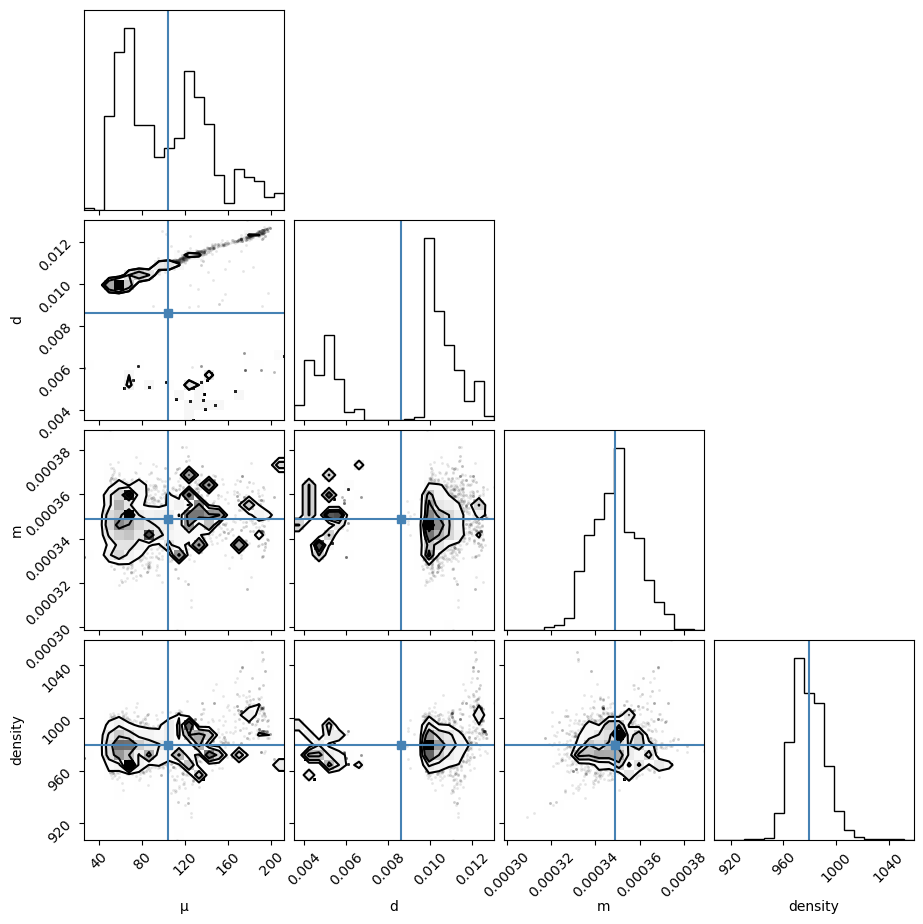

In [25]:
import numpy as np
import pandas as pd
from emcee import EnsembleSampler
from scipy.stats import norm
import corner
import matplotlib.pyplot as plt

# Load and prepare data
file_path = 'SphereDrop.xlsx'  # Replace with your actual file path
df = pd.read_excel(file_path, sheet_name='Sheet1', skiprows=2)

# Rename columns and convert units to SI
df.columns = ['Trial', 'Date', 'Diameter (mm)', 'Mass (g)', 'Height (cm)', 'Time (s)', 'Specific Density']
df = df.dropna().reset_index(drop=True)
df['Diameter (m)'] = df['Diameter (mm)'] * 0.001  # Diameter in meters
df['Radius (m)'] = df['Diameter (m)'] / 2  # Radius in meters
df['Mass (kg)'] = df['Mass (g)'] * 0.001  # Mass in kg
df['Height (m)'] = df['Height (cm)'] * 0.01  # Height in meters
df['Velocity (m/s)'] = df['Height (m)'] / df['Time (s)']  # Terminal velocity in m/s
rho_water = 1000  # Density of water in kg/m³
df['Density of Fluid (kg/m^3)'] = df['Specific Density'] * rho_water  # Fluid density in kg/m³

# Constants and measurement uncertainties
g = 9.81  # Gravity constant in m/s^2
sigma_d = 0.001  # Uncertainty in diameter (meters)
sigma_m = 1e-5  # Uncertainty in mass (kg)
sigma_t = 0.01  # Uncertainty in time (seconds)
sigma_density_fluid = 10  # Uncertainty in fluid density (kg/m³)

# Observed data
observed_d = df['Diameter (m)'].values
observed_m = df['Mass (kg)'].values
observed_t = df['Time (s)'].values
observed_H = df['Height (m)'].values
observed_density_fluid = df['Density of Fluid (kg/m^3)'].values

# Prior mean and uncertainty for viscosity (µ)
mu_0 = 125  # Initial guess for viscosity
sigma_mu = 50  # Uncertainty in viscosity

# Step 1: Define the prior with stricter bounds and debug prints
def prior(mu, d, m, density_fluid, sigma_d, sigma_m, sigma_density_fluid, mu_0, sigma_mu):
    # Set reasonable bounds for each parameter
    if not (50 < mu < 200) or not (0.001 < d < 0.02) or not (0.0001 < m < 0.01) or not (900 < density_fluid < 1100):
        print(f"Out of bounds in prior: mu={mu}, d={d}, m={m}, density_fluid={density_fluid}")
        return -np.inf  # Log probability is negative infinity for out-of-bounds values

    # Gaussian priors for each parameter within realistic ranges
    prior_mu = norm.logpdf(mu, loc=mu_0, scale=sigma_mu)
    prior_d = norm.logpdf(d, loc=np.mean(observed_d), scale=sigma_d).sum()
    prior_m = norm.logpdf(m, loc=np.mean(observed_m), scale=sigma_m).sum()
    prior_density = norm.logpdf(density_fluid, loc=np.mean(observed_density_fluid), scale=sigma_density_fluid).sum()
    
    print(f"Prior values: mu={prior_mu}, d={prior_d}, m={prior_m}, density={prior_density}")
    return prior_mu + prior_d + prior_m + prior_density

# Step 2: Define the likelihood with additional checks and debug prints
def likelihood(mu, d, m, density_fluid, observed_H, observed_t, sigma_t):
    # Calculate theoretical time based on Stokes' law
    denominator = (1/6) * density_fluid * g * np.pi * d**3 - m * g
    if np.any(denominator <= 0):  # Check for valid denominator
        print(f"Invalid denominator in likelihood calculation for mu={mu}, d={d}, m={m}, density={density_fluid}")
        return -np.inf

    theoretical_t = (3 * np.pi * d * mu * observed_H) / denominator
    print(f"Theoretical time: {theoretical_t}, Observed time: {observed_t}")
    return np.sum(norm.logpdf(observed_t, loc=theoretical_t, scale=sigma_t))

# Step 3: Define the posterior function with debug prints
def posterior(params, observed_H, observed_t, sigma_d, sigma_m, sigma_density_fluid, sigma_t):
    mu, d, m, density_fluid = params
    prior_val = prior(mu, d, m, density_fluid, sigma_d, sigma_m, sigma_density_fluid, mu_0, sigma_mu)
    if prior_val == -np.inf:
        print(f"Skipping likelihood due to prior rejection for params: {params}")
        return -np.inf
    likelihood_val = likelihood(mu, d, m, density_fluid, observed_H, observed_t, sigma_t)
    print(f"Posterior value: prior={prior_val}, likelihood={likelihood_val}")
    return prior_val + likelihood_val

# Initialize MCMC sampler with realistic initial guesses
nwalkers = 50
nsteps = 1000
initial_guess = np.array([mu_0, np.mean(observed_d), np.mean(observed_m), np.mean(observed_density_fluid)])
initial_positions = np.random.normal(initial_guess, [sigma_mu, sigma_d, sigma_m, sigma_density_fluid], size=(nwalkers, 4))

sampler = EnsembleSampler(
    nwalkers, 
    4,  # Sampling four parameters: µ, d, m, and density of fluid
    posterior, 
    args=(observed_H, observed_t, sigma_d, sigma_m, sigma_density_fluid, sigma_t)
)

# Step 4: Run MCMC sampling and debug if issues arise
sampler.run_mcmc(initial_positions, nsteps, progress=True)
samples = sampler.get_chain(discard=100, thin=10, flat=True)

# Analyze MCMC results
mu_mean, d_mean, m_mean, density_fluid_mean = np.mean(samples, axis=0)
mu_std, d_std, m_std, density_fluid_std = np.std(samples, axis=0)

print(f"Estimated viscosity (µ): Mean = {mu_mean:.4f} Pa.s, Std = {mu_std:.4f} Pa.s")
print(f"Estimated diameter (d): Mean = {d_mean:.4f} m, Std = {d_std:.4f} m")
print(f"Estimated mass (m): Mean = {m_mean:.6f} kg, Std = {m_std:.6f} kg")
print(f"Estimated fluid density: Mean = {density_fluid_mean:.2f} kg/m³, Std = {density_fluid_std:.2f} kg/m³")

# Corner plot
fig_full = corner.corner(samples, labels=["µ", "d", "m", "density"], truths=[mu_mean, d_mean, m_mean, density_fluid_mean])
fig_full.savefig("full_corner_plot.png", dpi=300)
plt.show()


## Question 3

/Users/liting/anaconda3/envs/emcee/lib/python3.13/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in scalar subtract
  lnpdiff = f + nlp - state.log_prob[j]


Date: 2015-07-10 00:00:00
  Mean viscosity (μ): 100.7464 Pa.s
  Std deviation: 44.4605 Pa.s


Date: 2015-07-13 00:00:00
  Mean viscosity (μ): 115.6614 Pa.s
  Std deviation: 51.9998 Pa.s
Date: 2015-07-14 00:00:00
  Mean viscosity (μ): 68.3544 Pa.s
  Std deviation: 40.2937 Pa.s


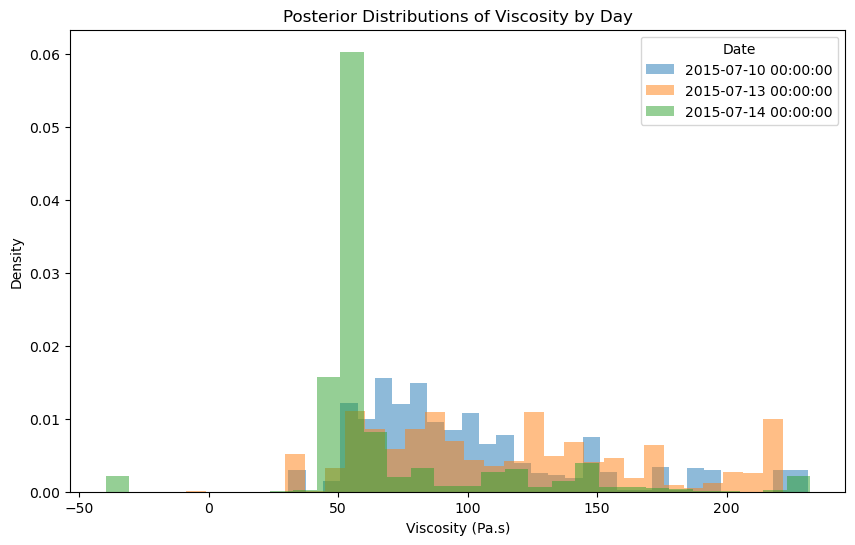

In [27]:
import numpy as np
import pandas as pd
from emcee import EnsembleSampler
from scipy.stats import norm
import corner
import matplotlib.pyplot as plt

# Load and prepare data
file_path = 'SphereDrop.xlsx'  # Replace with your actual file path
df = pd.read_excel(file_path, sheet_name='Sheet1', skiprows=2)

# Rename columns and convert units to SI
df.columns = ['Trial', 'Date', 'Diameter (mm)', 'Mass (g)', 'Height (cm)', 'Time (s)', 'Specific Density']
df = df.dropna().reset_index(drop=True)
df['Diameter (m)'] = df['Diameter (mm)'] * 0.001  # Diameter in meters
df['Radius (m)'] = df['Diameter (m)'] / 2  # Radius in meters
df['Mass (kg)'] = df['Mass (g)'] * 0.001  # Mass in kg
df['Height (m)'] = df['Height (cm)'] * 0.01  # Height in meters
df['Velocity (m/s)'] = df['Height (m)'] / df['Time (s)']  # Terminal velocity in m/s
rho_water = 1000  # Density of water in kg/m³
df['Density of Fluid (kg/m^3)'] = df['Specific Density'] * rho_water  # Fluid density in kg/m³

# Constants and measurement uncertainties
g = 9.81  # Gravity constant in m/s^2
sigma_d = 0.001  # Uncertainty in diameter (meters)
sigma_m = 1e-5  # Uncertainty in mass (kg)
sigma_t = 0.01  # Uncertainty in time (seconds)
sigma_density_fluid = 10  # Uncertainty in fluid density (kg/m³)

# Prior mean and uncertainty for viscosity (μ)
mu_0 = 125  # Initial guess for viscosity
sigma_mu = 50  # Uncertainty in viscosity

# Define the prior
def prior(mu, d, m, density_fluid, sigma_d, sigma_m, sigma_density_fluid, mu_0, sigma_mu):
    if not (50 < mu < 200) or not (0.001 < d < 0.02) or not (0.0001 < m < 0.01) or not (900 < density_fluid < 1100):
        return -np.inf  # Log probability is negative infinity for out-of-bounds values
    prior_mu = norm.logpdf(mu, loc=mu_0, scale=sigma_mu)
    prior_d = norm.logpdf(d, loc=np.mean(observed_d), scale=sigma_d).sum()
    prior_m = norm.logpdf(m, loc=np.mean(observed_m), scale=sigma_m).sum()
    prior_density = norm.logpdf(density_fluid, loc=np.mean(observed_density_fluid), scale=sigma_density_fluid).sum()
    return prior_mu + prior_d + prior_m + prior_density

# Define the likelihood
def likelihood(mu, d, m, density_fluid, observed_H, observed_t, sigma_t):
    denominator = (1/6) * density_fluid * g * np.pi * d**3 - m * g
    if np.any(denominator <= 0):
        return -np.inf
    theoretical_t = (3 * np.pi * d * mu * observed_H) / denominator
    return np.sum(norm.logpdf(observed_t, loc=theoretical_t, scale=sigma_t))

# Define the posterior
def posterior(params, observed_H, observed_t, sigma_d, sigma_m, sigma_density_fluid, sigma_t):
    mu, d, m, density_fluid = params
    prior_val = prior(mu, d, m, density_fluid, sigma_d, sigma_m, sigma_density_fluid, mu_0, sigma_mu)
    if prior_val == -np.inf:
        return -np.inf
    likelihood_val = likelihood(mu, d, m, density_fluid, observed_H, observed_t, sigma_t)
    return prior_val + likelihood_val

# MCMC parameters
nwalkers = 50
nsteps = 1000

# Run MCMC for each day and store the viscosity posteriors
unique_dates = df['Date'].unique()
posterior_samples = {}
posterior_stats = {}

for date in unique_dates:
    # Filter data for the specific day
    day_data = df[df['Date'] == date]
    observed_d = day_data['Diameter (m)'].values
    observed_m = day_data['Mass (kg)'].values
    observed_t = day_data['Time (s)'].values
    observed_H = day_data['Height (m)'].values
    observed_density_fluid = day_data['Density of Fluid (kg/m^3)'].values

    # Initial guess for parameters
    initial_guess = np.array([mu_0, np.mean(observed_d), np.mean(observed_m), np.mean(observed_density_fluid)])
    initial_positions = np.random.normal(initial_guess, [sigma_mu, sigma_d, sigma_m, sigma_density_fluid], size=(nwalkers, 4))

    # Set up the sampler
    sampler = EnsembleSampler(nwalkers, 4, posterior, args=(observed_H, observed_t, sigma_d, sigma_m, sigma_density_fluid, sigma_t))
    
    # Run the MCMC sampling
    sampler.run_mcmc(initial_positions, nsteps, progress=True)
    samples = sampler.get_chain(discard=100, thin=10, flat=True)
    
    # Store the posterior samples for viscosity (μ) only
    posterior_samples[date] = samples[:, 0]

    # Calculate mean and standard deviation for viscosity (μ) posterior
    mu_mean = np.mean(posterior_samples[date])
    mu_std = np.std(posterior_samples[date])
    posterior_stats[date] = {'mean': mu_mean, 'std': mu_std}

    print(f"Date: {date}")
    print(f"  Mean viscosity (μ): {mu_mean:.4f} Pa.s")
    print(f"  Std deviation: {mu_std:.4f} Pa.s")

# Plot the posterior distributions for viscosity across the different days
plt.figure(figsize=(10, 6))
for date, samples_mu in posterior_samples.items():
    plt.hist(samples_mu, bins=30, density=True, alpha=0.5, label=f'{date}')

plt.xlabel('Viscosity (Pa.s)')
plt.ylabel('Density')
plt.title('Posterior Distributions of Viscosity by Day')
plt.legend(title='Date')
plt.show()



Question 4

You must install the tqdm library to use progress indicators with emcee


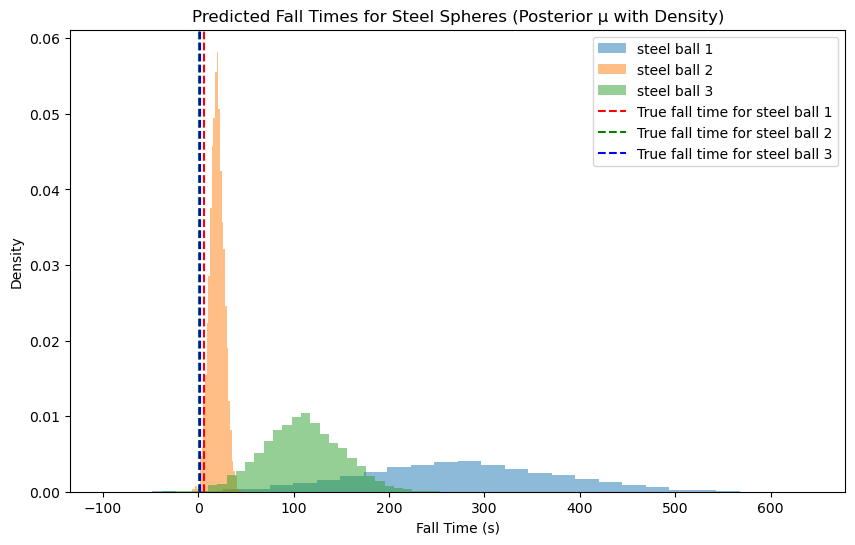

In [9]:
import numpy as np
import pandas as pd
from emcee import EnsembleSampler
from scipy.stats import norm
import matplotlib.pyplot as plt

# Load the data from the table
data = {
    'material': ['teflon', 'steel', 'steel', 'steel'],
    'd (mm)': [12.7, 4.76, 9.53, 6.35],
    'height start (cm)': [2.658, 5.404, 0.38, 8.687],
    'height end (cm)': [3.848, 23.586, 5.544, 21.49],
    't start (s)': [200, 1.5, 0.3, 0.667],
    't end (s)': [250, 5.583, 0.67, 1.333]
}
df = pd.DataFrame(data)

# Convert units to SI
df['d (m)'] = df['d (mm)'] * 0.001  # Diameter in meters
df['radius (m)'] = df['d (m)'] / 2  # Radius in meters
df['height start (m)'] = df['height start (cm)'] * 0.01  # Height in meters
df['height end (m)'] = df['height end (cm)'] * 0.01  # Height in meters
df['velocity (m/s)'] = (df['height end (m)'] - df['height start (m)']) / (df['t end (s)'] - df['t start (s)'])

# Material densities (in kg/m^3) based on approximate values from the internet
densities = {'teflon': 2150, 'steel': 7850}  # kg/m^3

# Calculate mass using volume and material density
df['mass (kg)'] = (4/3) * np.pi * (df['radius (m)']**3) * df['material'].map(densities)

# Separate Teflon and Steel sphere data
teflon_df = df[df['material'] == 'teflon']
steel_df = df[df['material'] == 'steel']

# Constants
g = 9.81  # Gravity constant in m/s^2
sigma_d = 0.001  # Measurement uncertainty in diameter (meters)
sigma_m = 0.01  # Uncertainty in mass (kg)
sigma_H = 0.01  # Uncertainty in height (m)
sigma_mu = 50  # Uncertainty in viscosity (Pa.s)
sigma_density = 10  # Uncertainty in fluid density (kg/m^3)

# Assumed density of fluid for the prior
rho_fluid = 1000  # Mean fluid density in kg/m^3

# Observed data for Teflon sphere
observed_d_teflon = teflon_df['radius (m)'].values[0]
observed_H_teflon = teflon_df['height end (m)'].values[0] - teflon_df['height start (m)'].values[0]
observed_m_teflon = teflon_df['mass (kg)'].values[0]
observed_velocity_teflon = teflon_df['velocity (m/s)'].values[0]

# Prior mean and initial guess for viscosity
mu_0 = 125  # Initial guess for viscosity

# Define the prior function for μ, H, d, m, and density based on Teflon sphere data
def prior(mu, H, d, m, density):
    prior_mu = norm.logpdf(mu, loc=mu_0, scale=sigma_mu)
    prior_H = norm.logpdf(H, loc=observed_H_teflon, scale=sigma_H)
    prior_d = norm.logpdf(d, loc=observed_d_teflon, scale=sigma_d)
    prior_m = norm.logpdf(m, loc=observed_m_teflon, scale=sigma_m)
    prior_density = norm.logpdf(density, loc=rho_fluid, scale=sigma_density)
    return prior_mu + prior_H + prior_d + prior_m + prior_density

# Define the likelihood function based on Teflon sphere velocity data
def likelihood(mu, H, d, m, density, observed_velocity, sigma_v=0.01):
    # Calculate theoretical velocity based on viscosity μ and density difference
    theoretical_v = (2 * g * d**2 * (densities['teflon'] - density)) / (9 * mu)
    return norm.logpdf(observed_velocity, loc=theoretical_v, scale=sigma_v)

# Define the posterior function
def posterior(params, observed_velocity):
    mu, H, d, m, density = params
    prior_val = prior(mu, H, d, m, density)
    if prior_val == -np.inf:
        return -np.inf
    likelihood_val = likelihood(mu, H, d, m, density, observed_velocity)
    return prior_val + likelihood_val

# MCMC setup
nwalkers = 50
nsteps = 1000
initial_guess = [mu_0, observed_H_teflon, observed_d_teflon, observed_m_teflon, rho_fluid]
initial_positions = np.random.normal(initial_guess, [sigma_mu, sigma_H, sigma_d, sigma_m, sigma_density], size=(nwalkers, 5))

# Run MCMC
sampler = EnsembleSampler(nwalkers, 5, posterior, args=(observed_velocity_teflon,))
sampler.run_mcmc(initial_positions, nsteps, progress=True)
samples = sampler.get_chain(discard=100, thin=10, flat=True)

# Extract posterior samples for μ
mu_samples = samples[:, 0]

# Predict fall times for each steel sphere using posterior μ samples
fall_times = {f"steel ball {i+1}": [] for i in range(len(steel_df))}
for mu in mu_samples:
    for i, (_, row) in enumerate(steel_df.iterrows()):
        d_steel = row['radius (m)']
        height_steel = row['height end (m)'] - row['height start (m)']
        density_diff = densities['steel'] - rho_fluid  # Difference in density between steel and water
        v_theoretical = (2 * g * d_steel**2 * density_diff) / (9 * mu)
        t_pred = height_steel / v_theoretical
        fall_times[f"steel ball {i+1}"].append(t_pred)

# Plotting predicted fall times with true observed fall times
plt.figure(figsize=(10, 6))
for i, (key, times) in enumerate(fall_times.items()):
    plt.hist(times, bins=30, density=True, alpha=0.5, label=key)

# Define colors for true fall time lines
true_time_colors = ['r', 'g', 'b']

# Add vertical lines for true fall times of each steel ball with different colors
true_times = steel_df['t end (s)'].values
for i, (true_time, color) in enumerate(zip(true_times, true_time_colors)):
    plt.axvline(true_time, color=color, linestyle='--', label=f"True fall time for {list(fall_times.keys())[i]}")

plt.xlabel("Fall Time (s)")
plt.ylabel("Density")
plt.title("Predicted Fall Times for Steel Spheres (Posterior μ with Density)")
plt.legend()
plt.show()


Question 5

You must install the tqdm library to use progress indicators with emcee


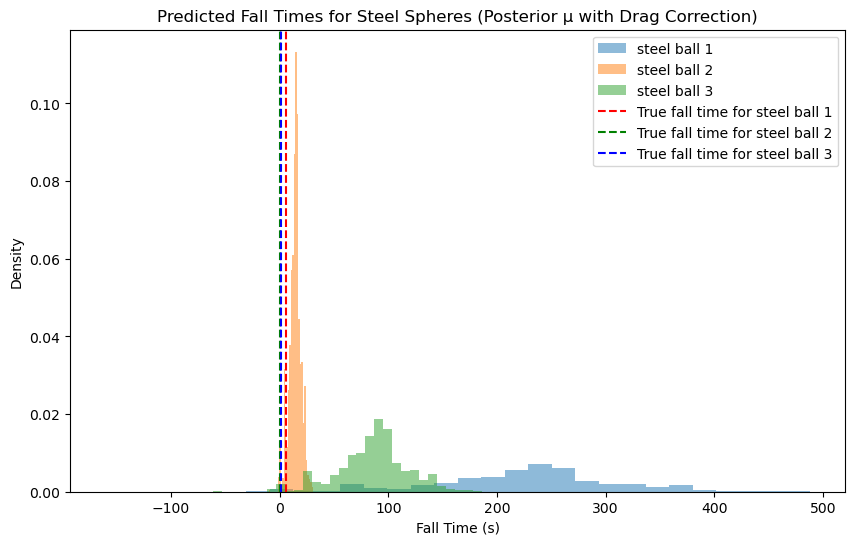

In [8]:
import numpy as np
import pandas as pd
from emcee import EnsembleSampler
from scipy.stats import norm
import matplotlib.pyplot as plt

# Load the data from the table
data = {
    'material': ['teflon', 'steel', 'steel', 'steel'],
    'd (mm)': [12.7, 4.76, 9.53, 6.35],
    'height start (cm)': [2.658, 5.404, 0.38, 8.687],
    'height end (cm)': [3.848, 23.586, 5.544, 21.49],
    't start (s)': [200, 1.5, 0.3, 0.667],
    't end (s)': [250, 5.583, 0.67, 1.333]
}
df = pd.DataFrame(data)

# Convert units to SI
df['d (m)'] = df['d (mm)'] * 0.001  # Diameter in meters
df['radius (m)'] = df['d (m)'] / 2  # Radius in meters
df['height start (m)'] = df['height start (cm)'] * 0.01  # Height in meters
df['height end (m)'] = df['height end (cm)'] * 0.01  # Height in meters
df['velocity (m/s)'] = (df['height end (m)'] - df['height start (m)']) / (df['t end (s)'] - df['t start (s)'])

# Material densities (in kg/m^3) based on approximate values from the internet
densities = {'teflon': 2150, 'steel': 7850}  # kg/m^3

# Calculate mass using volume and material density
df['mass (kg)'] = (4/3) * np.pi * (df['radius (m)']**3) * df['material'].map(densities)

# Separate Teflon and Steel sphere data
teflon_df = df[df['material'] == 'teflon']
steel_df = df[df['material'] == 'steel']

# Constants
g = 9.81  # Gravity constant in m/s^2
sigma_d = 0.001  # Measurement uncertainty in diameter (meters)
sigma_m = 0.01  # Uncertainty in mass (kg)
sigma_H = 0.01  # Uncertainty in height (m)
sigma_mu = 50  # Uncertainty in viscosity (Pa.s)
sigma_density = 10  # Uncertainty in fluid density (kg/m^3)
sigma_b = np.sqrt(teflon_df['d (m)'].values[0] / 2)  # Uncertainty in b

# Assumed fluid density and cylinder diameter
rho_fluid = 1000  # Density of water in kg/m^3
D_cylinder = 0.1  # Assumed diameter of the cylinder (in meters)

# Observed data for Teflon sphere
observed_d_teflon = teflon_df['radius (m)'].values[0]
observed_H_teflon = teflon_df['height end (m)'].values[0] - teflon_df['height start (m)'].values[0]
observed_m_teflon = teflon_df['mass (kg)'].values[0]
observed_velocity_teflon = teflon_df['velocity (m/s)'].values[0]

# Prior mean and initial guess for viscosity
mu_0 = 125  # Initial guess for viscosity

# Define the drag correction factor
def drag_correction_factor(d, b, D):
    beta = (2 * b) / D
    alpha = d / D
    correction = 1 - (2.1044 - 0.6977 * beta**2) * alpha
    return correction

# Define the prior function for μ, H, d, m, b, and density based on Teflon sphere data
def prior(mu, H, d, m, b, density):
    prior_mu = norm.logpdf(mu, loc=mu_0, scale=sigma_mu)
    prior_H = norm.logpdf(H, loc=observed_H_teflon, scale=sigma_H)
    prior_d = norm.logpdf(d, loc=observed_d_teflon, scale=sigma_d)
    prior_m = norm.logpdf(m, loc=observed_m_teflon, scale=sigma_m)
    prior_density = norm.logpdf(density, loc=rho_fluid, scale=sigma_density)
    prior_b = norm.logpdf(b, loc=d / 2, scale=sigma_b)
    return prior_mu + prior_H + prior_d + prior_m + prior_density + prior_b

# Define the likelihood function with the updated μ_new using the drag correction factor
def likelihood(mu, H, d, m, b, density, observed_velocity, sigma_v=0.01):
    correction_factor = drag_correction_factor(d * 2, b, D_cylinder)
    mu_new = correction_factor * ((m * g - (1/6) * density * np.pi * d**3 * g) / (3 * np.pi * d * observed_velocity))
    return norm.logpdf(observed_velocity, loc=mu_new, scale=sigma_v)

# Define the posterior function
def posterior(params, observed_velocity):
    mu, H, d, m, b, density = params
    prior_val = prior(mu, H, d, m, b, density)
    if prior_val == -np.inf:
        return -np.inf
    likelihood_val = likelihood(mu, H, d, m, b, density, observed_velocity)
    return prior_val + likelihood_val

# MCMC setup
nwalkers = 50
nsteps = 1000
initial_guess = [mu_0, observed_H_teflon, observed_d_teflon, observed_m_teflon, observed_d_teflon / 2, rho_fluid]
initial_positions = np.random.normal(initial_guess, [sigma_mu, sigma_H, sigma_d, sigma_m, sigma_b, sigma_density], size=(nwalkers, 6))

# Run MCMC
sampler = EnsembleSampler(nwalkers, 6, posterior, args=(observed_velocity_teflon,))
sampler.run_mcmc(initial_positions, nsteps, progress=True)
samples = sampler.get_chain(discard=100, thin=10, flat=True)

# Extract posterior samples for μ
mu_samples = samples[:, 0]

# Predict fall times for each steel sphere using posterior μ samples
fall_times = {f"steel ball {i+1}": [] for i in range(len(steel_df))}
for mu in mu_samples:
    for i, (_, row) in enumerate(steel_df.iterrows()):
        d_steel = row['radius (m)']
        height_steel = row['height end (m)'] - row['height start (m)']
        b_steel = d_steel / 2  # Estimate b as D/2 for steel spheres
        correction_factor = drag_correction_factor(d_steel * 2, b_steel, D_cylinder)
        mu_new = correction_factor * mu
        density_diff = densities['steel'] - rho_fluid  # Difference in density between steel and water
        v_theoretical = (2 * g * d_steel**2 * density_diff) / (9 * mu_new)
        t_pred = height_steel / v_theoretical
        fall_times[f"steel ball {i+1}"].append(t_pred)

# Plotting predicted fall times with true observed fall times
plt.figure(figsize=(10, 6))
for i, (key, times) in enumerate(fall_times.items()):
    plt.hist(times, bins=30, density=True, alpha=0.5, label=key)

# Define colors for true fall time lines
true_time_colors = ['r', 'g', 'b']

# Add vertical lines for true fall times of each steel ball with different colors
true_times = steel_df['t end (s)'].values
for i, (true_time, color) in enumerate(zip(true_times, true_time_colors)):
    plt.axvline(true_time, color=color, linestyle='--', label=f"True fall time for {list(fall_times.keys())[i]}")

plt.xlabel("Fall Time (s)")
plt.ylabel("Density")
plt.title("Predicted Fall Times for Steel Spheres (Posterior μ with Drag Correction)")
plt.legend()
plt.show()

Question 6

In [10]:
import numpy as np
import pandas as pd

# Given data
data = {
    'material': ['teflon', 'steel', 'steel', 'steel'],
    'd (mm)': [12.7, 4.76, 9.53, 6.35],
    'height start (cm)': [2.658, 5.404, 0.38, 8.687],
    'height end (cm)': [3.848, 23.586, 5.544, 21.49],
    't start (s)': [200, 1.5, 0.3, 0.667],
    't end (s)': [250, 5.583, 0.67, 1.333]
}
df = pd.DataFrame(data)

# Convert units to SI
df['d (m)'] = df['d (mm)'] * 0.001  # Diameter in meters
df['radius (m)'] = df['d (m)'] / 2  # Radius in meters
df['height start (m)'] = df['height start (cm)'] * 0.01  # Height in meters
df['height end (m)'] = df['height end (cm)'] * 0.01  # Height in meters
df['velocity (m/s)'] = (df['height end (m)'] - df['height start (m)']) / (df['t end (s)'] - df['t start (s)'])

# Material densities (in kg/m^3) based on approximate values from the internet
densities = {'teflon': 2150, 'steel': 7850}  # kg/m^3

# Calculate mass using volume and material density
df['mass (kg)'] = (4/3) * np.pi * (df['radius (m)']**3) * df['material'].map(densities)

# Constants
g = 9.81  # Gravity constant in m/s^2
D_cylinder = 0.1  # Assumed cylinder diameter in meters

# Calculate mean and standard deviation of `b` from Q5's posterior results
# Assume `b_posterior_samples` is the array of posterior samples of `b` obtained in Q5
# Here, we're using a placeholder mean and standard deviation for `b`
b_mean = 0.02  # Placeholder mean of b
b_std = 0.005  # Placeholder standard deviation of b

# Function to calculate partial derivative of mu_new with respect to b
def d_mu_new_db(b, d, m, D, V_t, density_fluid):
    factor = 5.5816 * (b * d * (m * g - (1/6) * density_fluid * np.pi * D**3 * g)) / (D**3 * 3 * np.pi * d * V_t)
    return factor

# Loop over each trial to compute ∂μ_new/∂b using the mean value of b
sensitivity_results = []
for i, row in df.iterrows():
    d = row['d (m)']
    m = row['mass (kg)']
    D = D_cylinder
    V_t = row['velocity (m/s)']
    density_fluid = 1000  # Assuming water density
    
    # Calculate ∂μ_new/∂b for the current trial
    sensitivity = d_mu_new_db(b_mean, d, m, D, V_t, density_fluid)
    sensitivity_results.append(sensitivity)

# Convert results to DataFrame for easier handling and display
sensitivity_df = pd.DataFrame({
    'Trial': df.index + 1,
    'Material': df['material'],
    'd (m)': df['d (m)'],
    'Mass (kg)': df['mass (kg)'],
    'Velocity (m/s)': df['velocity (m/s)'],
    '∂μ_new/∂b': sensitivity_results
})

# Display the sensitivity results
print(sensitivity_df)

# Calculate mean and standard deviation of ∂μ_new/∂b
sensitivity_mean = np.mean(sensitivity_results)
sensitivity_std = np.std(sensitivity_results)

print(f"Mean of ∂μ_new/∂b: {sensitivity_mean}")
print(f"Standard deviation of ∂μ_new/∂b: {sensitivity_std}")


   Trial Material    d (m)  Mass (kg)  Velocity (m/s)      ∂μ_new/∂b
0      1   teflon  0.01270   0.002306        0.000238 -254502.107897
1      2    steel  0.00476   0.000443        0.044531   -1365.070541
2      3    steel  0.00953   0.003558        0.139568    -432.952126
3      4    steel  0.00635   0.001052        0.192237    -315.844917
Mean of ∂μ_new/∂b: -64153.99387044355
Standard deviation of ∂μ_new/∂b: 109898.28687152808
